# <span style="color:blue">GDD Analysis - Template</span>

#### Original Data Extracted from VCF File

In [1]:
from GDDfunctions import *

In [2]:
vcf_crop = '/home/anibal/genome_files/Sorghum_2018_GATK_D1-D6.vcf'

In [ ]:
samples_all, vcf_df, chrom_len = VCFtoTable(vcf_crop)

In [6]:
samples_all

array(['Con', 'D1', 'D2', 'D2_F1', 'D3', 'D3_F1', 'D4', 'D5', 'D6'],
      dtype=object)

In [7]:
# edit progenitor/mutant names accordingly
progenitor = 'Con'
mutant = 'D2'
samples = [progenitor, mutant]
samples

['Con', 'D2']

In [8]:
vcf_df

,CHROM,POS,REF,ALT,QUAL,DP,Con_DP,D1_DP,D2_DP,D2_F1_DP,...,Con_AD,D1_AD,D2_AD,D2_F1_AD,D3_AD,D3_F1_AD,D4_AD,D5_AD,D6_AD,AN
0,Chr01,275,C,T,2676.620117,98,28,5,16,2,...,0/28,0/5,0/16,0/2,0/19,0/5,0/7,0/6,0/7,18
1,Chr01,438,T,C,5907.479980,231,56,29,38,8,...,0/56,0/29,0/38,0/8,0/27,0/4,0/27,0/17,0/23,18
2,Chr01,465,GAAGCT,G,8912.759766,212,53,27,33,6,...,0/53,0/27,0/33,0/6,0/26,0/3,0/25,2/11,0/21,18
3,Chr01,744,C,A,4485.470215,172,43,14,18,5,...,0/43,0/14,0/18,0/5,0/28,0/10,0/18,0/15,0/20,18
4,Chr01,871,C,T,5509.450195,199,54,17,33,13,...,0/54,0/17,0/33,0/13,0/19,0/7,0/13,0/20,0/23,18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4637681,Chr10,61229413,G,GGGC,640.530029,34,3,3,1,1,...,0/3,0/3,0/1,1/0,0/3,0/0,0/4,0/1,3/0,12
4637682,Chr10,61229493,A,G,537.919983,30,4,3,5,3,...,0/4,3/0,0/5,0/3,0/5,0/0,0/3,1/0,0/2,12
4637683,Chr10,61232654,A,C,207.240005,17,5,2,3,0,...,0/5,0/2,3/0,0/0,4/0,0/0,0/2,1/0,0/0,6
4637684,Chr10,61232670,T,C,372.640015,18,7,2,3,0,...,0/7,0/2,0/3,0/0,0/1,0/0,0/3,0/1,1/0,12


In [9]:
chrom_len

,LEN
CHROM,
Chr01,80884392
Chr02,77742459
Chr03,74386277
Chr04,68658214
Chr05,71854669
Chr06,61277060
Chr07,65505356
Chr08,62686529
Chr09,59416394


## <span style="color:blue"> PART 0: Raw </span>

#### Contingency Table - RAW - All Chromosomes - (No 0/0, 0/1, 1/1 Filtered)

In [10]:
contingency_table_0 = contingency_table(samples, vcf_df, 'all')


Contingency Table - Chromosome all

               D2_GT                         
                 0/0     0/1      1/1   other
Con_GT 0/0    731432  308570    23075  423595
       0/1    364166  756303    53294  423595
       1/1     19461   40049  1917741  423595
       other  423595  423595   423595  423595


#### GT Plot - RAW - All Chromosomes - (No 0/0, 1/1, 'Other' GTs Filtered)

In [11]:
# plt.close('all')
# GTplot(samples, vcf_df, chrom_len)

#### Histograms - `DP`, `QUAL`, `TYPE` and `GT` Attributes - All Chromosomes - Unfiltered

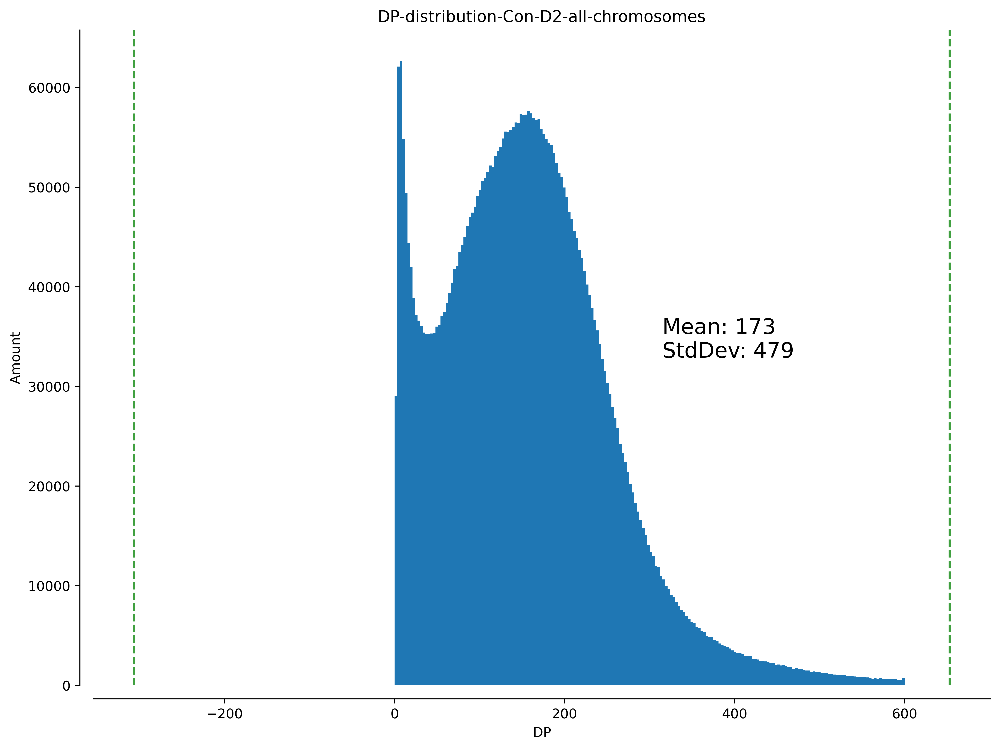

In [12]:
plot_variant_hist(samples, vcf_df, 'all', 'DP', bins=200, MSTD=True, xmax=600)

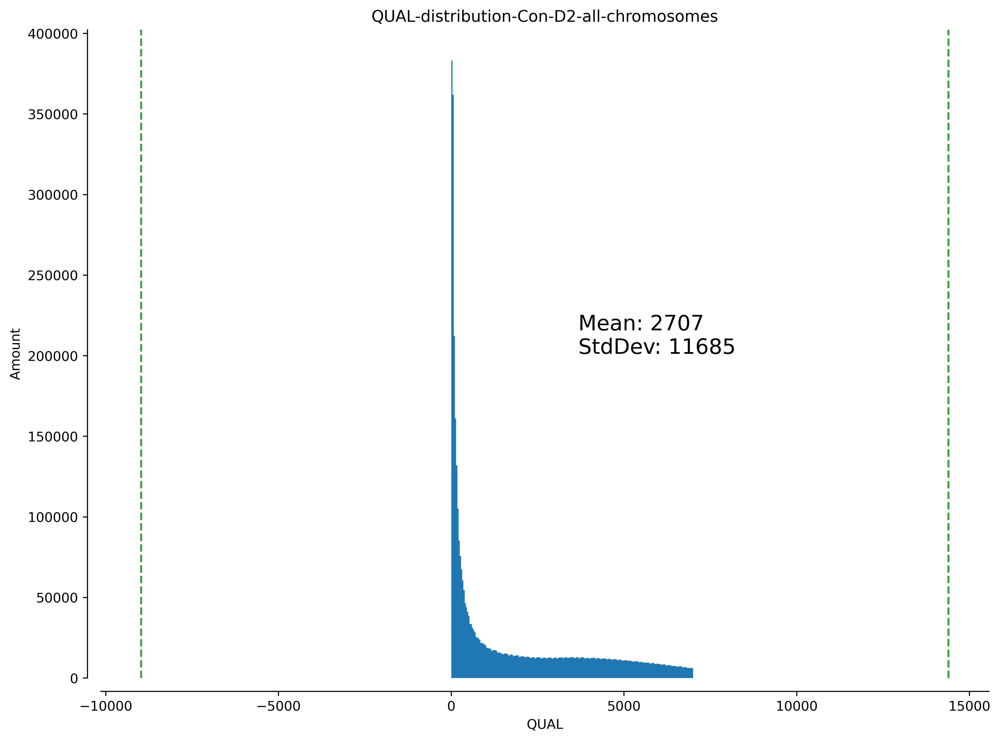

In [13]:
plot_variant_hist(samples, vcf_df, 'all', 'QUAL', bins=200,  MSTD=True, xmax=7000)

In [14]:
# plot_variant_hist(samples, vcf_df, 'all', 'TYPE', bins=5)

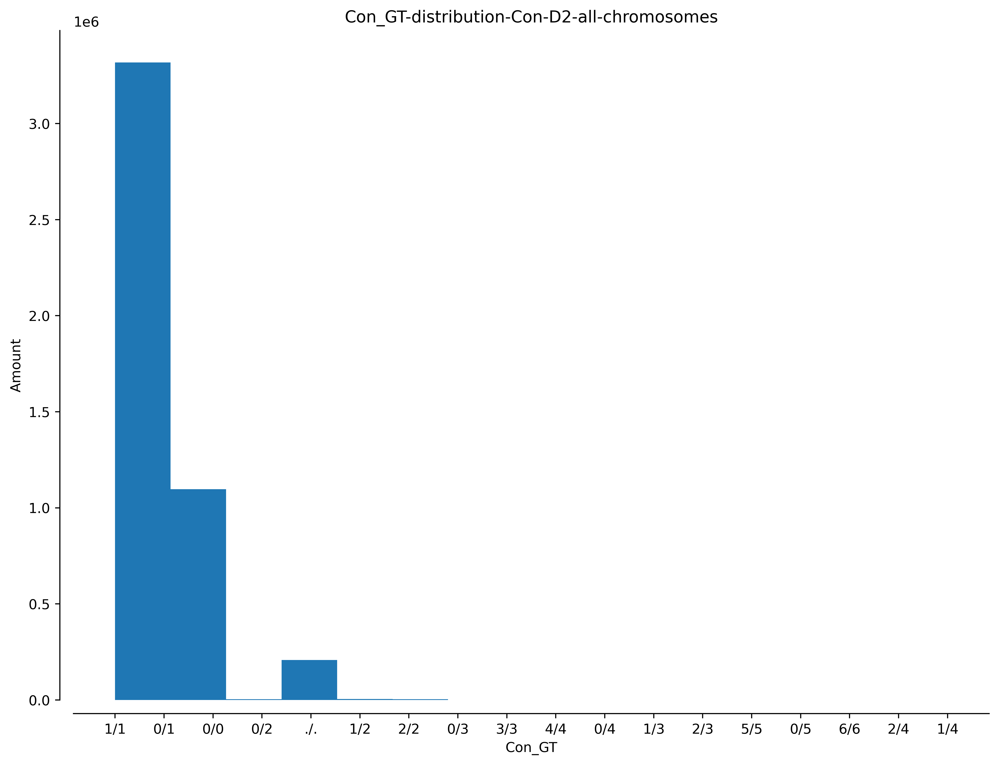

In [15]:
plot_variant_hist(samples, vcf_df, 'all', '%s_GT' % progenitor, bins=15)

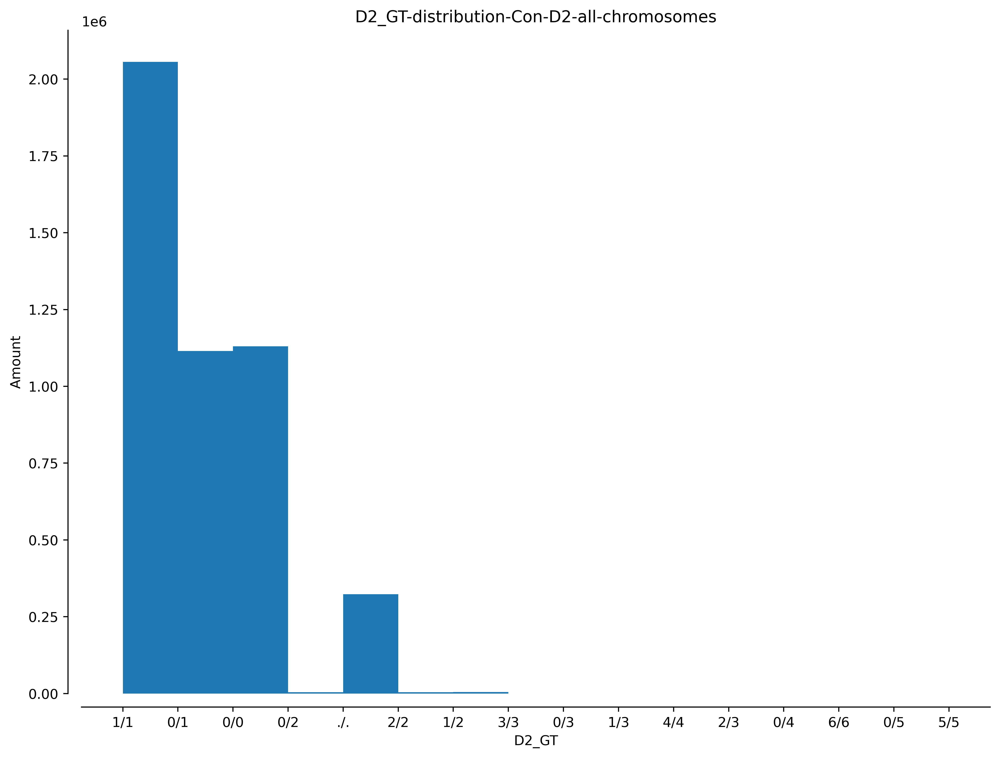

In [16]:
plot_variant_hist(samples, vcf_df, 'all', '%s_GT' % mutant, bins=15)

#### Stacked Bar Plots - RAW

In [17]:
ct_guide()

Mutant              
                    0/0 0/1 1/1 other
Progenitor 0/0        a   b   c      
           0/1        d   e   f      
           1/1        g   h   i      
           other                    j

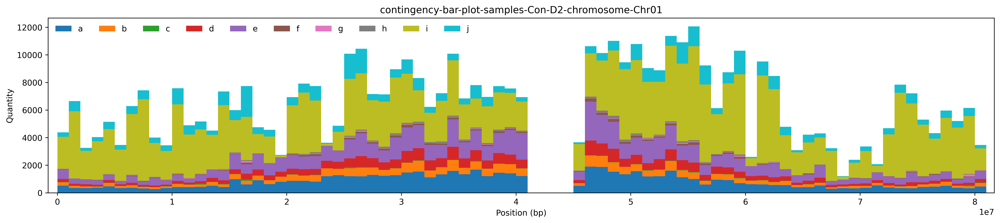

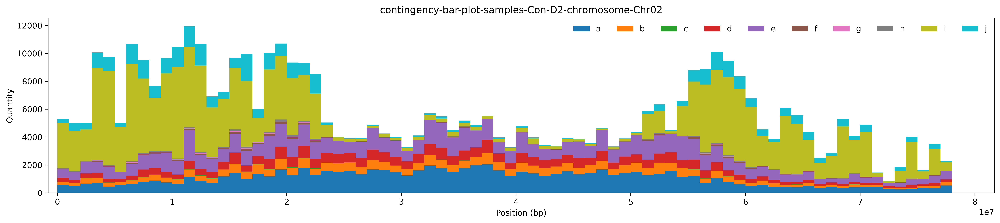

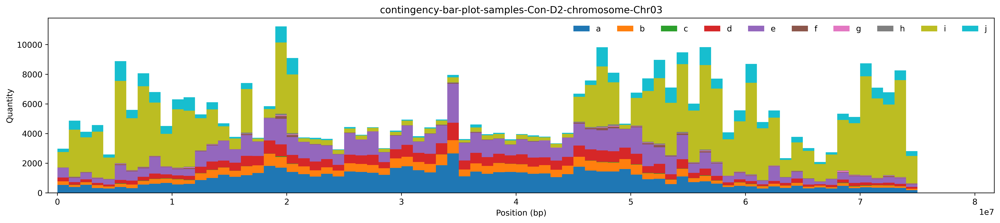

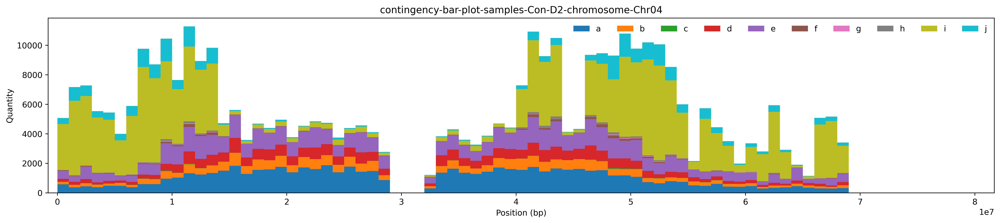

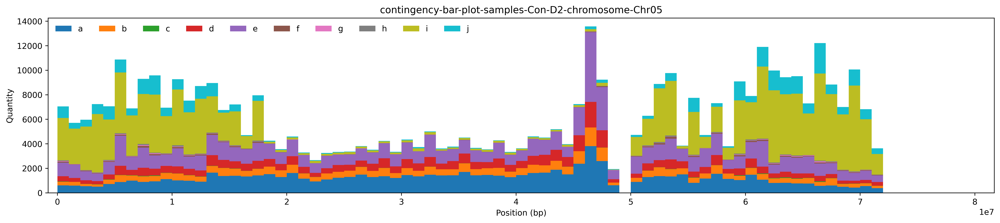

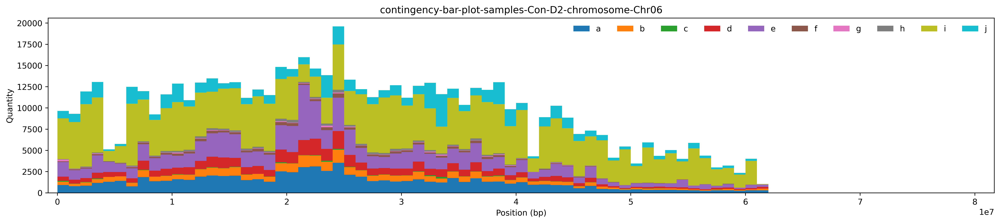

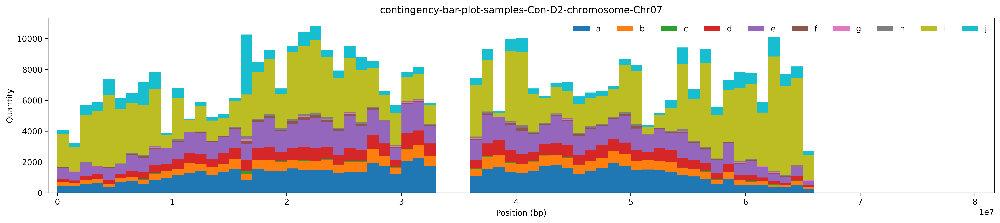

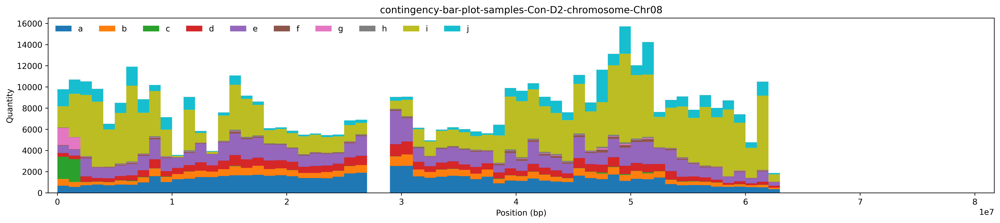

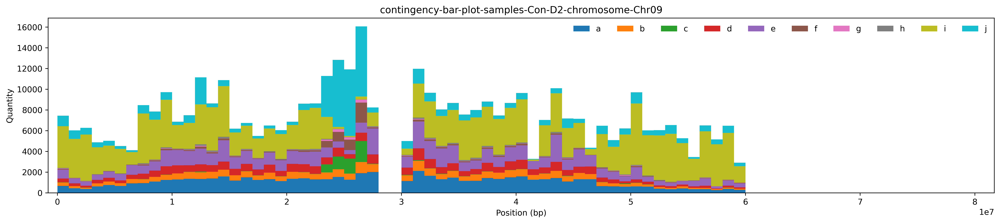

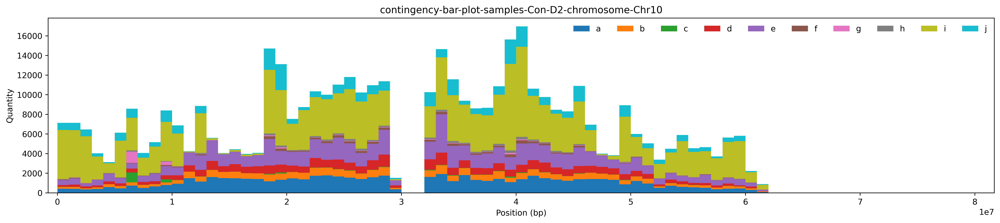

In [18]:
plt.close('all')
window_size = 1000000
CTbarPlots(samples, vcf_df, chrom_len, window_size)

## <span style="color:blue"> PART 1: Filter Out Mitochondria and Chloroplast Chromosomes </span>

#### Drop Mitochrondria and Chloroplast Chromosomes from `vcf_df` and `chrom_len`

In [19]:
# add as many mitochondria/chloroplast chromosomes to exclude separated by commas
# drop_mito_chloro = "CHROM != chrom_to_exclude_1, CHROM != chrom_to_exclude_2, ..., CHROM!=normal_chrom_N"
# vcf_df_00 = filter_vcf(vcf_df, drop_mito_chloro)
vcf_df_00 = vcf_df

In [20]:
# mito_chloro = ['chrom_to_exclude_1','chrom_to_exclude_2']
# chrom_len_00 = chrom_len.drop(mito_chloro)
chrom_len_00 = chrom_len

#### Create Mitochrondria and Chloroplast Variants and Chomosome Length Dataframes

In [21]:
# drop_chrom = "CHROM!=normal_chrom_1, CHROM!=normal_chrom_2, ..., CHROM!=normal_chrom_N"
# vcf_df_mito_chloro = filter_vcf(vcf_df, drop_chrom)
# vcf_df_mito_chloro

In [22]:
# mito_chloro_len = chrom_len.loc[mito_chloro]
# mito_chloro_len

#### Contingency Table - No Mitochondria/Chloroplast

In [23]:
# contingency_table_1 = contingency_table(samples, vcf_df_00, 'all')

#### GT Plot - No Mitochondria/Chloroplast

In [24]:
# plt.close('all')
# GTplot(samples, vcf_df_00, chrom_len_00)

#### Histograms - `DP`, `QUAL`, `TYPE` and `GT` Attributes - No Mitochondria/Chloroplast

In [25]:
# plot_variant_hist(samples, vcf_df_00, 'all', 'DP', bins=200, MSTD=True, xmax=600)

In [26]:
# plot_variant_hist(samples, vcf_df_00, 'all', 'QUAL', bins=200,  MSTD=True, xmax=7000)

In [27]:
# plot_variant_hist(samples, vcf_df_00, 'all', 'TYPE', bins=5)

In [28]:
# plot_variant_hist(samples, vcf_df_00, 'all', '%s_GT' % progenitor, bins=15)

In [29]:
# plot_variant_hist(samples, vcf_df_00, 'all', '%s_GT' % mutant, bins=15)

## <span style="color:blue">PART 2: Cutting Off by Mean±2StdDev Histograms of `DP` Attribute</span>

In [47]:
# cutoff_left = vcf_df_00.DP.mean() - (2 * vcf_df_00.DP.std())
cutoff_left = 50
cutoff_right = vcf_df_00.DP.mean() + (2 * vcf_df_00.DP.std())

filter_dp = "DP >= %i, DP <= %i" % (cutoff_left, cutoff_right)
print(filter_dp)

vcf_df_01 = filter_vcf(vcf_df_00, filter_dp)
vcf_df_01

DP >= 50, DP <= 1132


,CHROM,POS,REF,ALT,QUAL,DP,Con_DP,D1_DP,D2_DP,D2_F1_DP,...,Con_AD,D1_AD,D2_AD,D2_F1_AD,D3_AD,D3_F1_AD,D4_AD,D5_AD,D6_AD,AN
0,Chr01,275,C,T,2676.620117,98,28,5,16,2,...,0/28,0/5,0/16,0/2,0/19,0/5,0/7,0/6,0/7,18
1,Chr01,438,T,C,5907.479980,231,56,29,38,8,...,0/56,0/29,0/38,0/8,0/27,0/4,0/27,0/17,0/23,18
2,Chr01,465,GAAGCT,G,8912.759766,212,53,27,33,6,...,0/53,0/27,0/33,0/6,0/26,0/3,0/25,2/11,0/21,18
3,Chr01,744,C,A,4485.470215,172,43,14,18,5,...,0/43,0/14,0/18,0/5,0/28,0/10,0/18,0/15,0/20,18
4,Chr01,871,C,T,5509.450195,199,54,17,33,13,...,0/54,0/17,0/33,0/13,0/19,0/7,0/13,0/20,0/23,18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3932335,Chr10,61227120,CA,C,5331.169922,201,48,23,23,10,...,0/48,0/23,1/22,0/10,0/32,0/0,1/15,0/27,2/15,16
3932336,Chr10,61227430,G,T,4033.510010,158,41,12,27,9,...,0/41,1/11,2/25,0/9,0/22,0/3,0/16,0/12,0/16,18
3932337,Chr10,61228876,T,A,4011.520020,151,23,16,23,6,...,0/23,0/16,0/23,0/6,0/23,0/3,0/22,0/13,0/22,18
3932338,Chr10,61229259,G,C,842.760010,51,10,9,2,4,...,0/10,9/0,0/2,4/0,0/7,2/0,0/4,0/5,0/4,12


#### Verify DP Histogram Cutoff Off by Mean±2StdDev

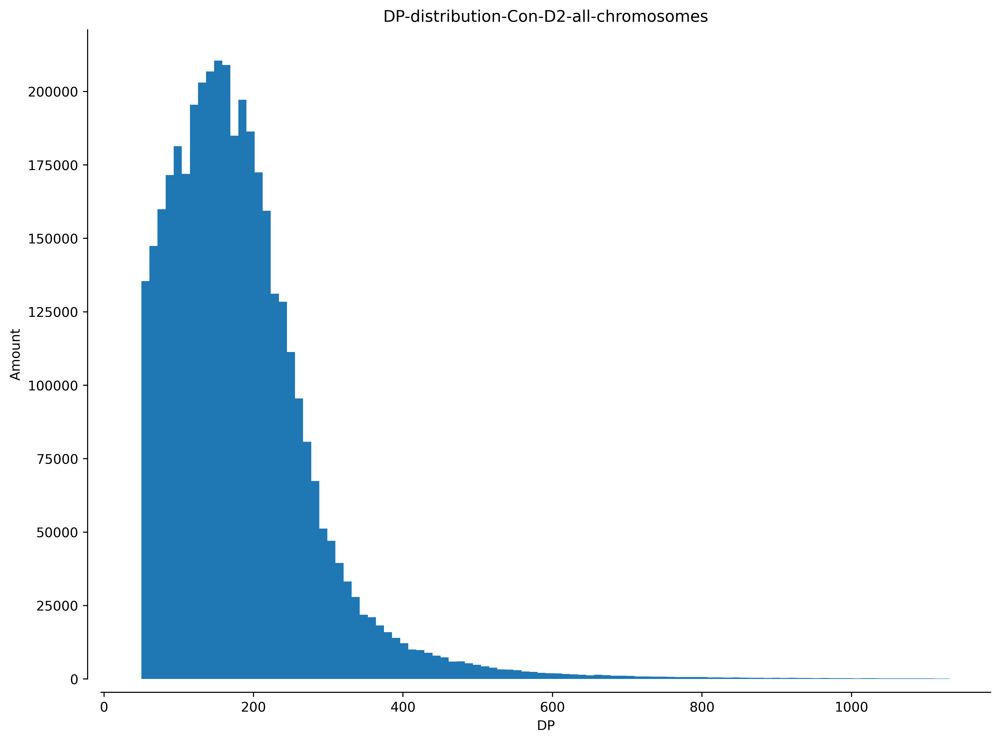

In [49]:
plot_variant_hist(samples, vcf_df_01, 'all', 'DP', bins=100)

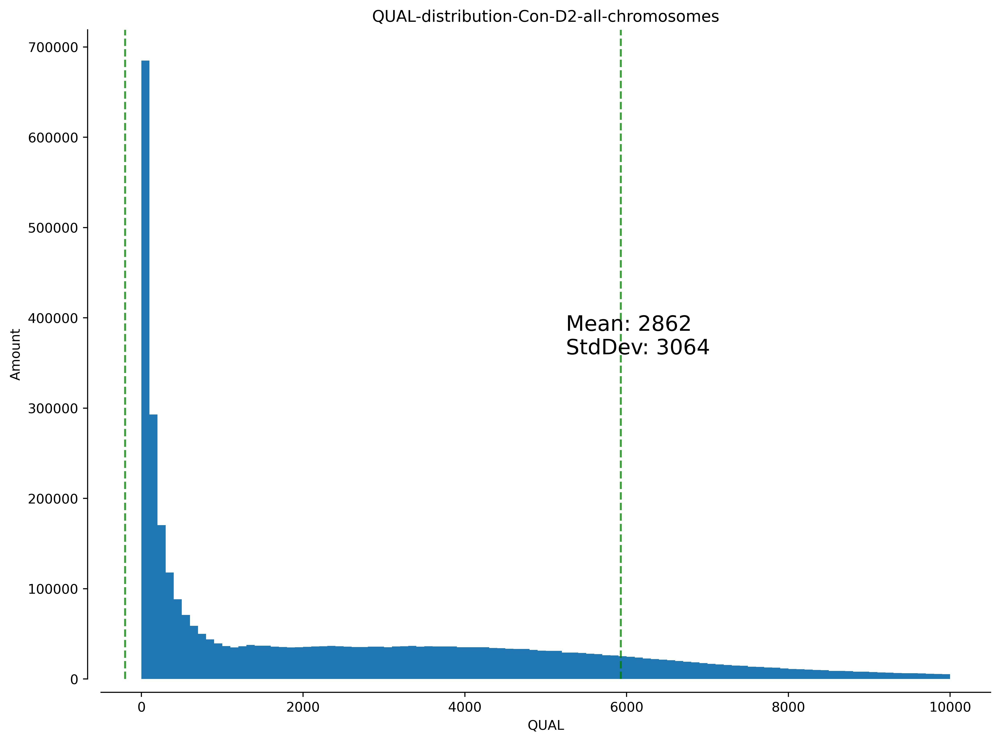

In [50]:
plot_variant_hist(samples, vcf_df_01, 'all', 'QUAL', bins=100, MSTD=True, xmax=10000)

#### Contingency Table After DP Cutoff by Mean±2StdDev

In [51]:
contingency_table_2 = contingency_table(samples, vcf_df_01, 'all')


Contingency Table - Chromosome all

               D2_GT                        
                 0/0     0/1      1/1  other
Con_GT 0/0    681332  290306    11000  93325
       0/1    323835  726883    35950  93325
       1/1      7333   31200  1731176  93325
       other   93325   93325    93325  93325


#### GT Plot After DP Cutoff by Mean±2StdDev

In [34]:
# plt.close('all')
# GTplot(samples, vcf_df_01, chrom_len_00)

#### Histogram 'GT' Attribute after DP Cutoff

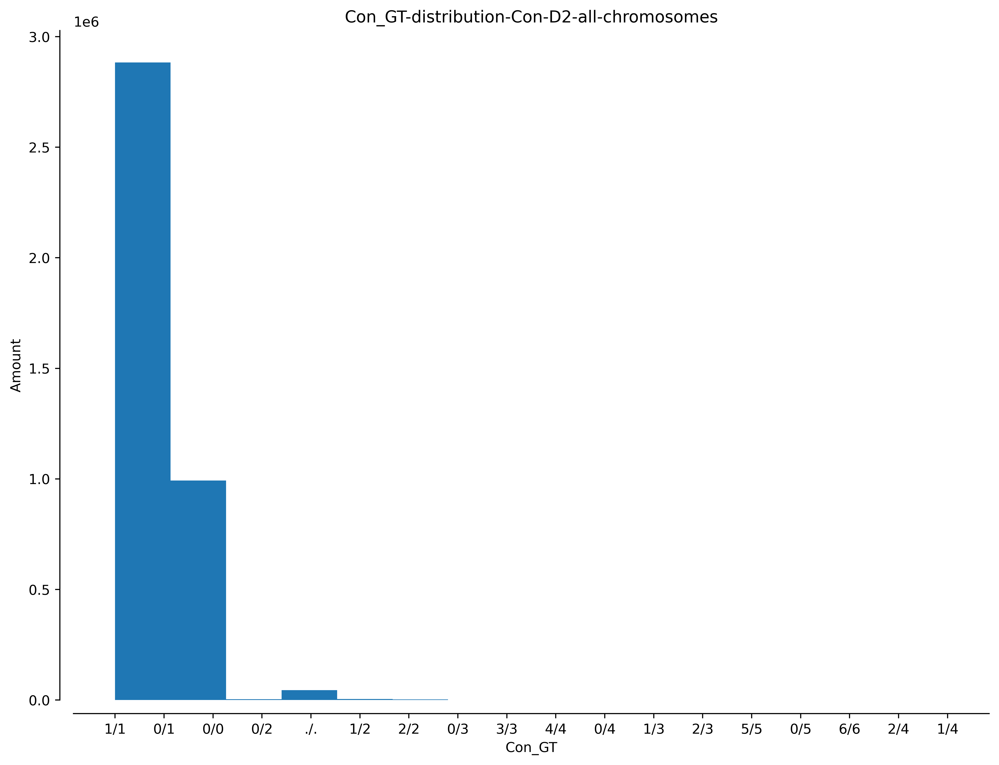

In [52]:
plot_variant_hist(samples, vcf_df_01, 'all', '%s_GT' % progenitor, bins=15)

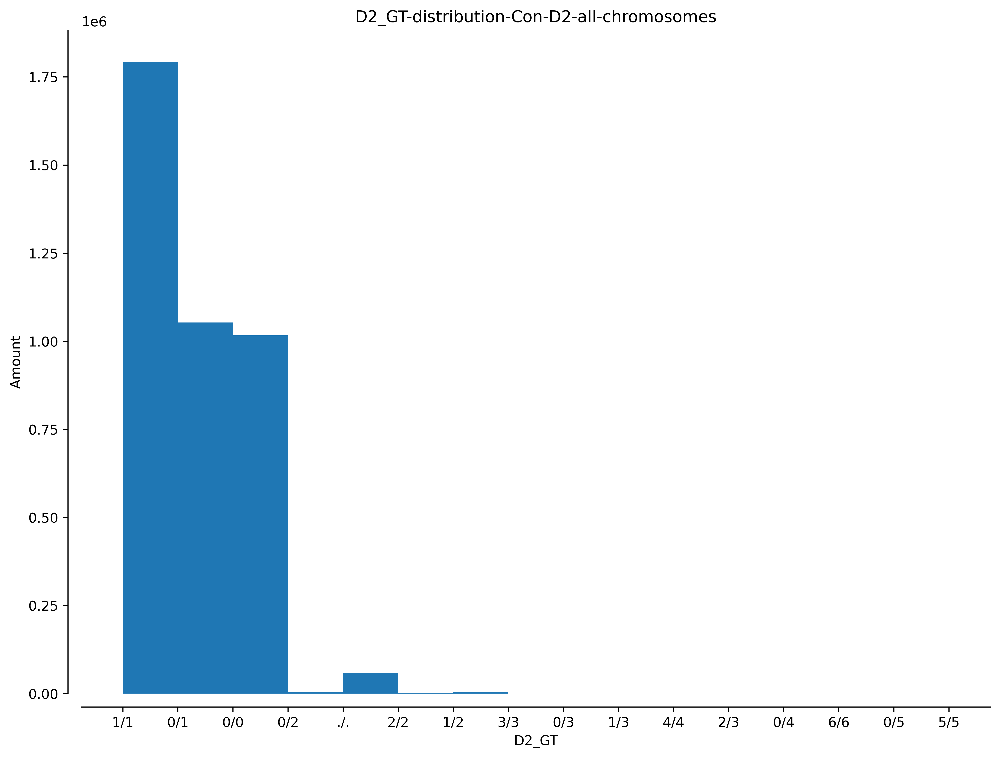

In [53]:
plot_variant_hist(samples, vcf_df_01, 'all', '%s_GT' % mutant, bins=15)

## <span style="color:blue"> PART 3: Extract Mutation `snp`/`mnp`/`ins`/`del`/`complex` from `TYPE` Attribute</span>

## Extract `snp`  `TYPE` Attribute - Freebayes Only!

In [55]:
# extract_type = "TYPE == snp"         # SNPs     
# extract_type = "TYPE == mnp"         # MNPs
# extract_type = "TYPE == complex"     # complex
# extract_type = "TYPE != snp, TYPE != mnp, TYPE != complex"     # InDels
# vcf_df_02 = filter_vcf(vcf_df_01, extract_type)
vcf_df_02 = vcf_df_01

#### TYPE `snp` Histogram Verification

In [ ]:
# plot_variant_hist(samples, vcf_df_02, 'all', 'TYPE', bins=5)

#### Contingency Table - `snp` TYPE only

In [ ]:
contingency_table_3 = contingency_table(samples, vcf_df_02, 'all')

#### GT Plot - `snp` TYPE only

In [ ]:
# plt.close('all')
# GTplot(samples, vcf_df_02, chrom_len_00)

#### Histograms - DP, QUAL, and GT Attributes after TYPE Filtering

In [ ]:
plot_variant_hist(samples, vcf_df_02, 'all', 'DP', bins=200, MSTD=True, xmax=600)

In [ ]:
plot_variant_hist(samples, vcf_df_02, 'all', 'QUAL', bins=200,  MSTD=True, xmax=7000)

In [ ]:
plot_variant_hist(samples, vcf_df_02, 'all', '%s_GT' % progenitor, bins=15)

In [ ]:
plot_variant_hist(samples, vcf_df_02, 'all', '%s_GT' % mutant, bins=15)

## <span style="color:blue"> PART 4: Cutting Off by Mean±StdDev Histograms of `QUAL` Attribute</span>

In [ ]:
# cutoff_left = vcf_df_02.QUAL.mean() - vcf_df_02.QUAL.std()
# cutoff_right = vcf_df_02.QUAL.mean() + vcf_df_02.QUAL.std()

# filter_qual = "QUAL >= %i, QUAL <= %i" % (cutoff_left, cutoff_right)
# print(filter_qual)

# vcf_df_03 = filter_vcf(vcf_df_02, filter_qual)
# vcf_df_03

#### Verify `DP` and `QUAL` Histograms after `QUAL` Cutoff Off by Mean±StdDev

In [ ]:
# plot_variant_hist(samples, vcf_df_03, 'all', 'DP', bins=200, xmax=200)

In [ ]:
# plot_variant_hist(samples, vcf_df_03, 'all', 'QUAL', bins=100, xmax=3500)

#### Contingency Table After QUAL Cutoff by Mean±StdDev

In [ ]:
# contingency_table_4 = contingency_table(samples, vcf_df_03, 'all')

#### GT Plot After QUAL Cutoff by Mean±StdDev

In [ ]:
# plt.close('all')
# GTplot(samples, vcf_df_03, chrom_len_00)

#### Histograms after QUAL Cutoff by Mean±StdDev

In [ ]:
# plot_variant_hist(samples, vcf_df_03, 'all', '%s_GT' % progenitor, bins=9)

In [ ]:
# plot_variant_hist(samples, vcf_df_03, 'all', '%s_GT' % mutant, bins=9)

## <span style="color:blue"> PART 5: Filtering GTs 0/0, 1/1, 'Other' </span>

#### Filter out where samples GTs are the same (0/0, 1/1) and have 'Other'

In [59]:
vcf_df_02['Con_GT']

0          1/1
1          1/1
2          1/1
3          1/1
4          1/1
          ... 
3932335    1/1
3932336    1/1
3932337    1/1
3932338    1/1
3932339    0/0
Name: Con_GT, Length: 3932340, dtype: object

In [56]:
samples

['Con', 'D2']

In [75]:
gt_con_filters = (vcf_df_02['Con_GT']=='0/0') | (vcf_df_02['Con_GT']=='0/1') | (vcf_df_02['Con_GT']=='1/1')
gt_d2_filters = (vcf_df_02['D2_GT']=='0/0') | (vcf_df_02['D2_GT']=='0/1') | (vcf_df_02['D2_GT']=='1/1')

In [78]:
vcf_df_04 = vcf_df_02[gt_con_filters & gt_d2_filters]

vcf_df_04.reset_index(inplace=True, drop=True)

In [79]:
contingency_table(samples, vcf_df_04, 'all')


Contingency Table - Chromosome all

               D2_GT                       
                 0/0     0/1      1/1 other
Con_GT 0/0    681332  290306    11000     0
       0/1    323835  726883    35950     0
       1/1      7333   31200  1731176     0
       other       0       0        0     0


D2_GT                       
                 0/0     0/1      1/1 other
Con_GT 0/0    681332  290306    11000     0
       0/1    323835  726883    35950     0
       1/1      7333   31200  1731176     0
       other       0       0        0     0

In [97]:
prog_filter = (vcf_df_02['Con_GT']=='0/0') 
mut_filter = (vcf_df_02['D2_GT']=='1/1')
vcf_df_05 = vcf_df_02[prog_filter & mut_filter]

vcf_df_05.reset_index(inplace=True, drop=True)

contingency_table(samples, vcf_df_05, 'all')


Contingency Table - Chromosome all

             D2_GT                 
               0/0 0/1    1/1 other
Con_GT 0/0       0   0  11000     0
       0/1       0   0      0     0
       1/1       0   0      0     0
       other     0   0      0     0


D2_GT                 
               0/0 0/1    1/1 other
Con_GT 0/0       0   0  11000     0
       0/1       0   0      0     0
       1/1       0   0      0     0
       other     0   0      0     0

In [81]:
vcf_df_04[['Con_GT', 'D2_GT']].head(1004)

,Con_GT,D2_GT
0,1/1,1/1
1,1/1,1/1
2,1/1,1/1
3,1/1,1/1
4,1/1,1/1
...,...,...
999,0/1,0/1
1000,0/1,0/1
1001,0/1,0/1
1002,0/0,0/1


In [84]:
# # change the progenitor name accordingly to filter out any other GTs present seen from GT Histogram
# progenitor_gts_filter = "Con_GT != ./., Con_GT != 0/2, Con_GT != 1/2, Con_GT != 2/2, Con_GT != 0/3, Con_GT != 1/3, Con_GT != 2/3, Con_GT != 3/3"

# # if uncommenting QUAL section to clip QUAL attribute, change vcf_df_02 to vcf_df_03 below
# vcf_df_04 = filter_vcf(vcf_df_02, progenitor_gts_filter)

# # change the progenitor name accordingly to filter out any other GTs present seen from GT Histogram
# mutant_gts_filter = "D2_GT != ./., D2_GT != 0/2, D2_GT != 1/2, D2_GT != 2/2, D2_GT != 0/3, D2_GT != 1/3, D2_GT != 2/3, D2_GT != 3/3"

# vcf_df_04 = filter_vcf(vcf_df_04, mutant_gts_filter)

genotypes = ['0/0', '0/1', '1/1']
for genotype in genotypes:
    vcf_df_04 = filter_similar_gt(samples, vcf_df_04, genotype)

vcf_df_04

,CHROM,POS,REF,ALT,QUAL,DP,Con_DP,D1_DP,D2_DP,D2_F1_DP,...,Con_AD,D1_AD,D2_AD,D2_F1_AD,D3_AD,D3_F1_AD,D4_AD,D5_AD,D6_AD,AN
0,Chr01,1489,G,GT,1673.619995,160,35,20,24,5,...,15/20,6/14,11/13,1/4,19/9,4/0,8/5,3/3,7/8,18
1,Chr01,1525,G,A,2024.709961,186,37,25,26,5,...,18/19,16/9,13/13,4/1,13/21,0/4,8/12,5/5,10/8,18
2,Chr01,1529,G,T,3600.600098,193,40,25,27,5,...,22/18,9/16,14/13,1/4,21/13,7/0,12/8,5/5,8/10,18
3,Chr01,1535,G,A,3625.600098,209,44,26,27,5,...,23/21,9/17,14/13,1/4,22/13,6/0,14/12,5/6,9/14,18
4,Chr01,1639,AC,A,4671.750000,378,70,40,30,6,...,34/36,18/22,18/12,5/1,25/28,4/3,20/29,17/33,27/21,18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426502,Chr10,61203575,G,C,225.169998,141,19,14,14,3,...,18/1,12/2,11/3,3/0,22/3,1/0,13/3,20/0,19/0,18
1426503,Chr10,61203592,C,A,203.860001,134,18,15,16,3,...,17/1,13/2,13/3,3/0,19/2,1/0,10/3,20/0,16/0,18
1426504,Chr10,61203616,CCGCCA,C,42.860001,136,22,17,20,3,...,22/0,16/1,18/2,3/0,24/0,2/0,8/2,16/0,19/0,18
1426505,Chr10,61220200,T,TAG,4392.529785,137,37,16,9,3,...,0/37,0/16,1/8,3/0,0/19,0/7,0/7,0/10,0/16,16


#### Contingency Table after GT Filtering

#### GT Plot after GT Filtering

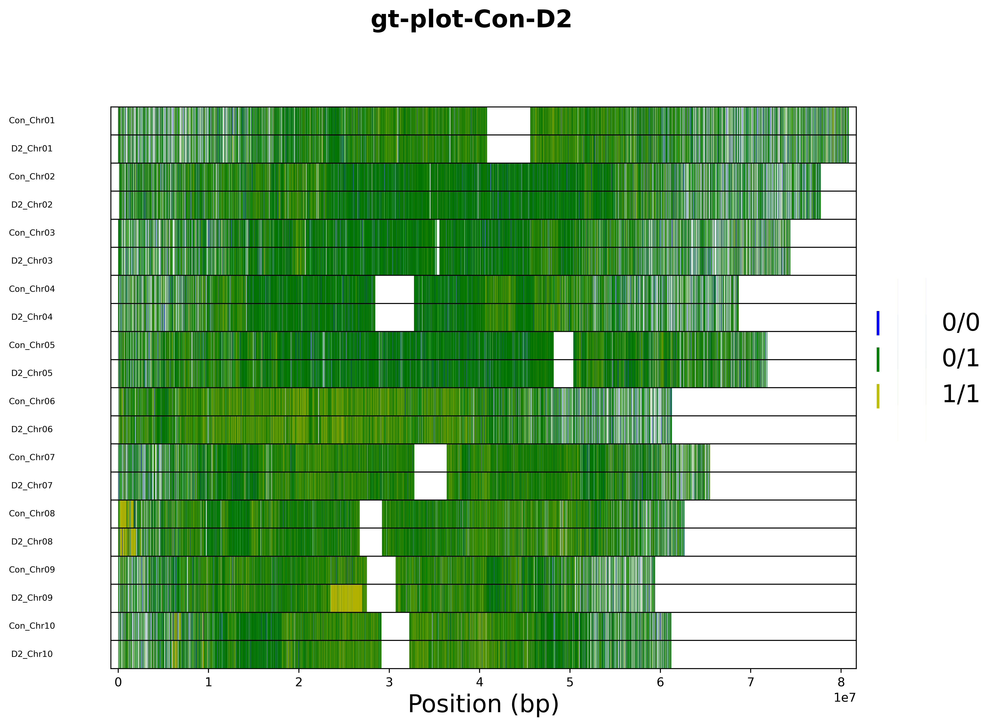

In [86]:
plt.close('all')
GTplot(samples, vcf_df_04, chrom_len_00)

#### Histograms GT after GT Filtering 

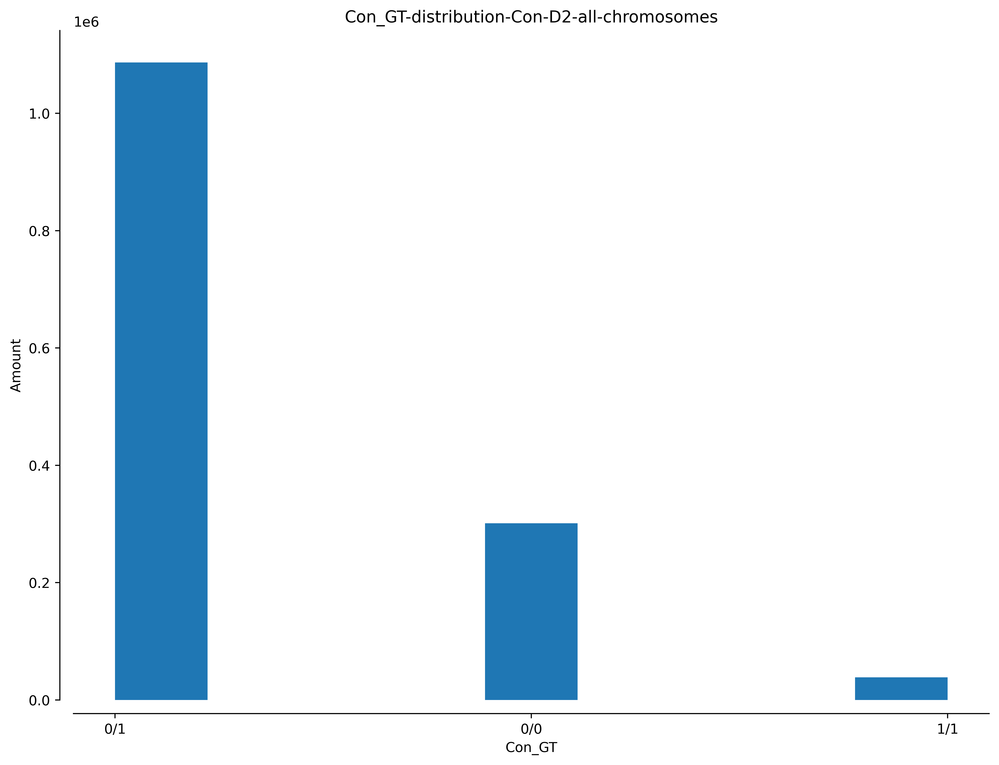

In [87]:
plot_variant_hist(samples, vcf_df_04, 'all', '%s_GT' % progenitor, bins=9)

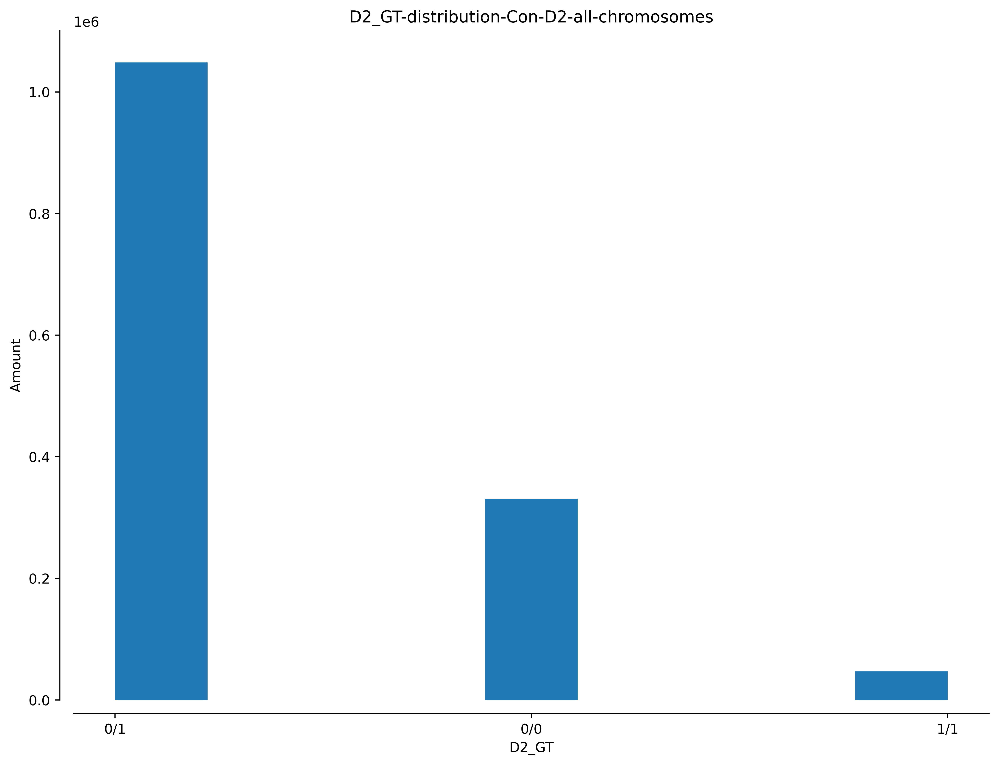

In [88]:
plot_variant_hist(samples, vcf_df_04, 'all', '%s_GT' % mutant, bins=9)

## <span style="color:blue"> PART 6: Stacked Bar Plots</span>

In [85]:
contingency_table_5 = contingency_table(samples, vcf_df_04, 'all')


Contingency Table - Chromosome all

               D2_GT                     
                 0/0     0/1    1/1 other
Con_GT 0/0         0  290306  11000     0
       0/1    323835  726883  35950     0
       1/1      7333   31200      0     0
       other       0       0      0     0


In [89]:
ct_guide()

Mutant              
                    0/0 0/1 1/1 other
Progenitor 0/0        a   b   c      
           0/1        d   e   f      
           1/1        g   h   i      
           other                    j

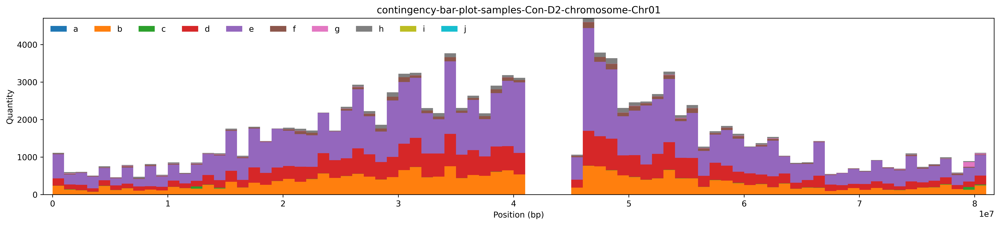

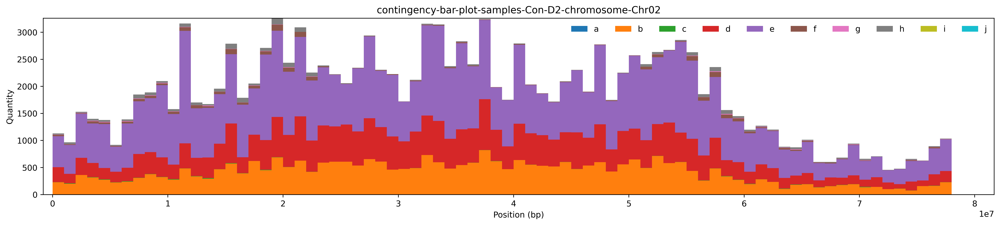

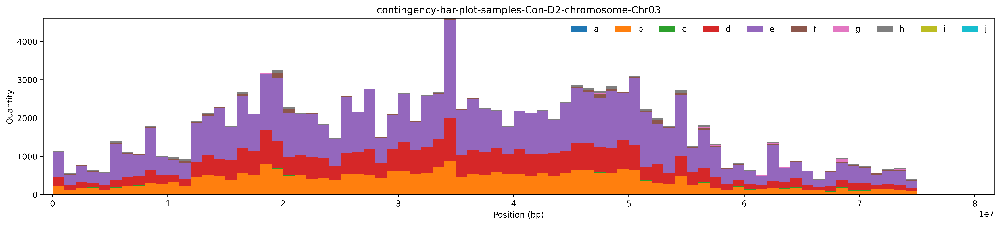

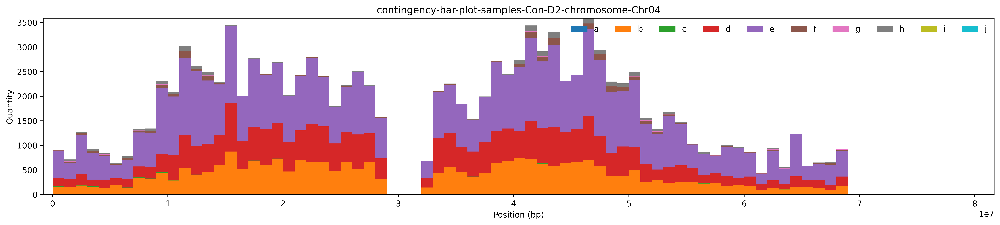

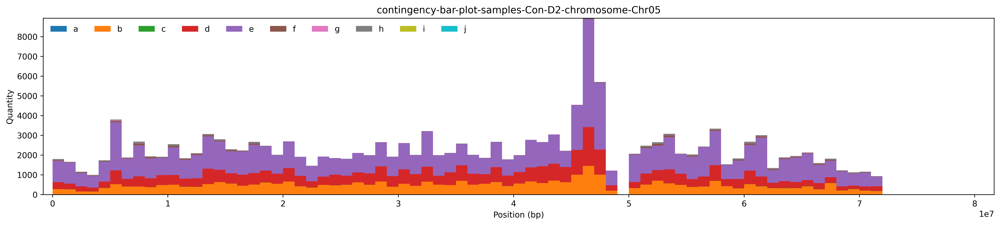

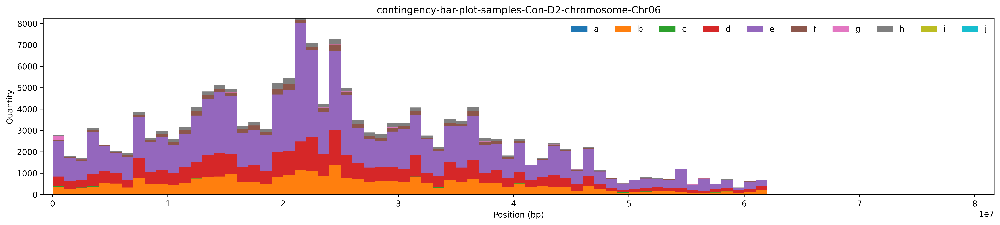

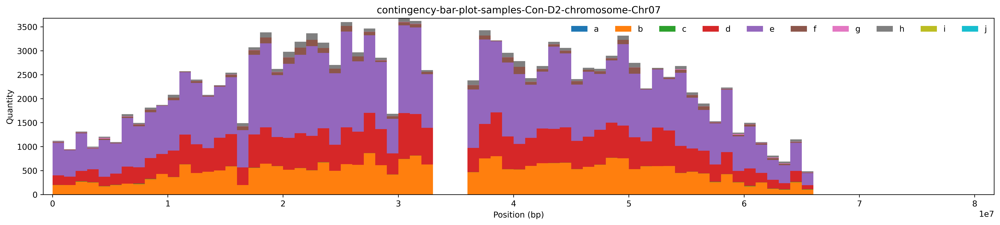

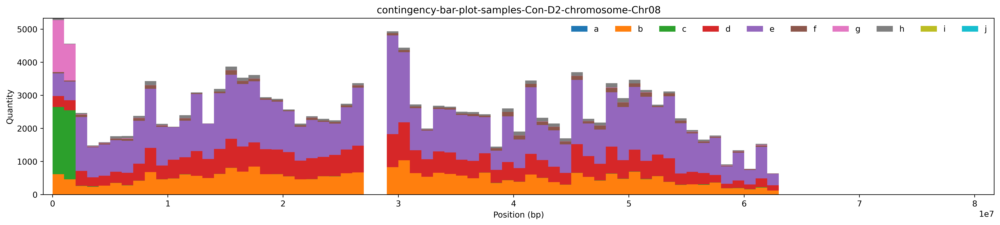

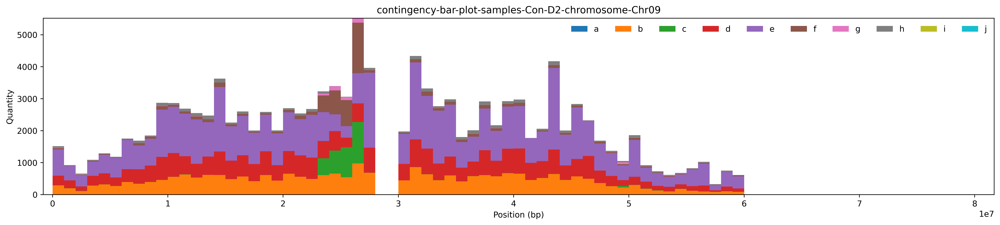

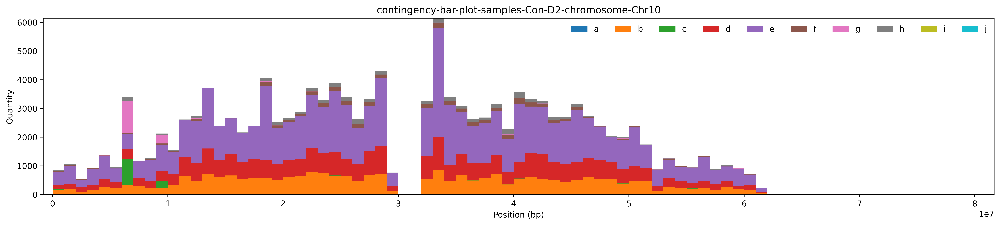

In [90]:
plt.close('all')
window_size = 1000000
CTbarPlots(samples, vcf_df_04, chrom_len_00, window_size)

## <span style="color:blue"> PART 7: Bar Plots per Chromosome</span>

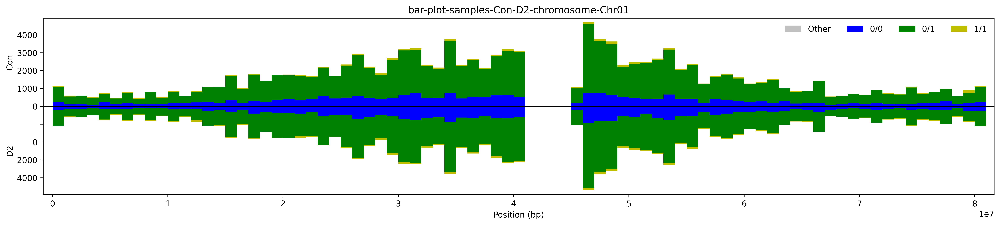

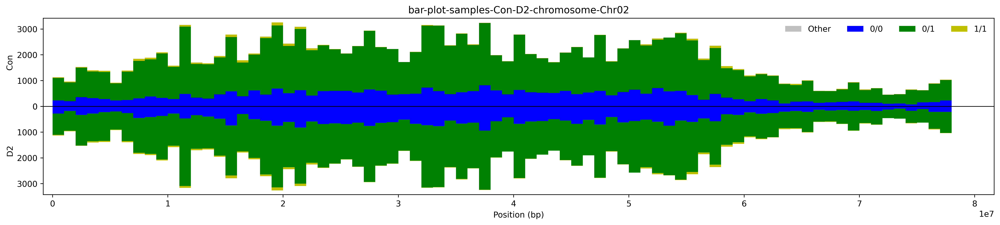

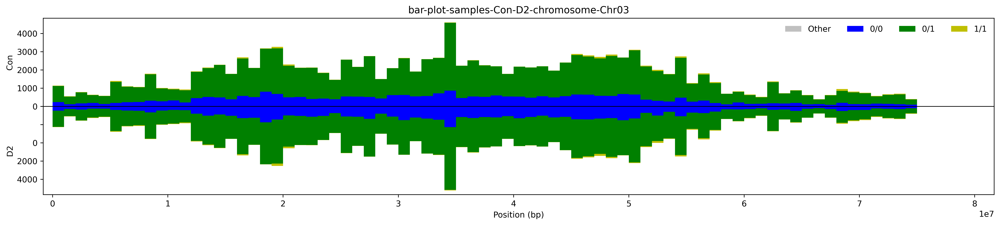

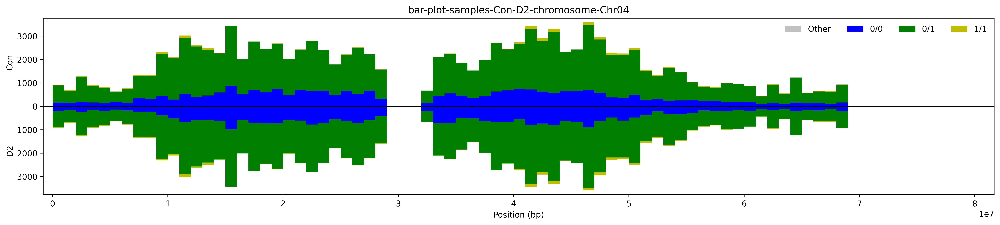

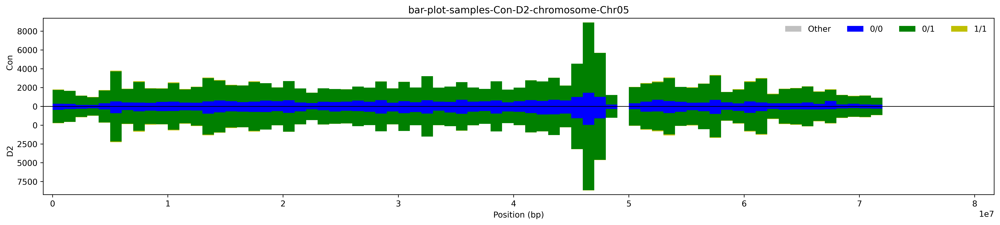

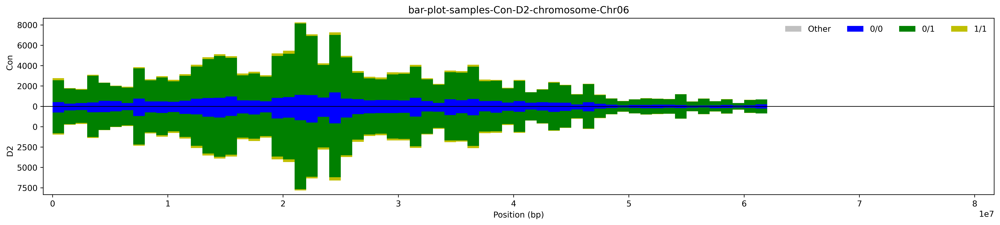

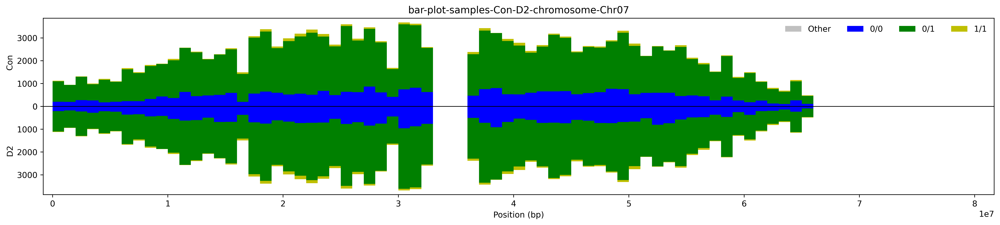

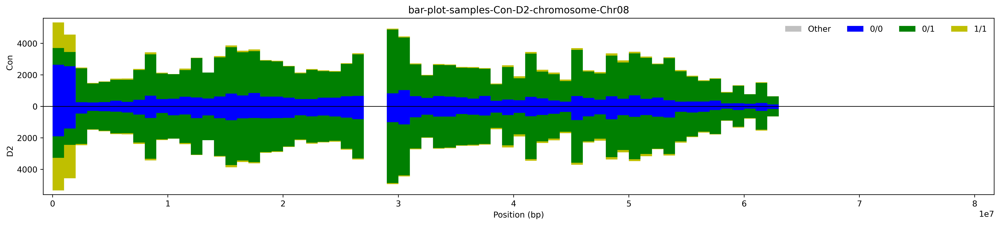

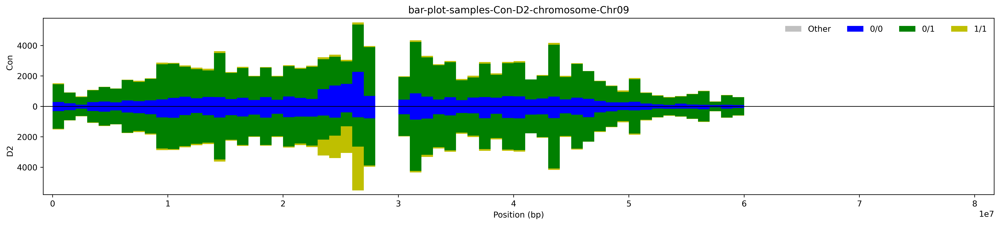

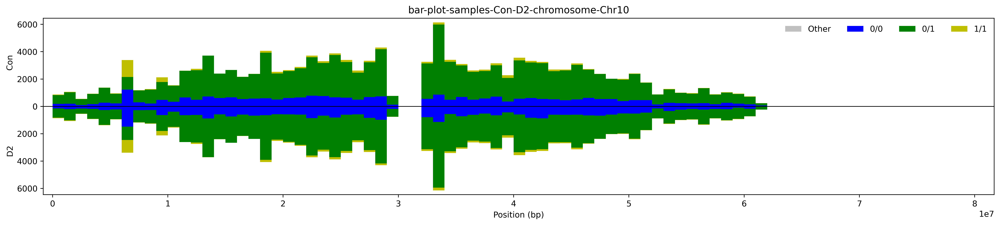

In [91]:
# suppress all the warnings from the inverted tickes of bar plots
import warnings
warnings.filterwarnings('ignore')

plt.close('all')
GTbarPlots(samples, vcf_df_04, chrom_len_00, window_size)

## <span style="color:blue"> PART 8: GT Plots per Chromosome</span>

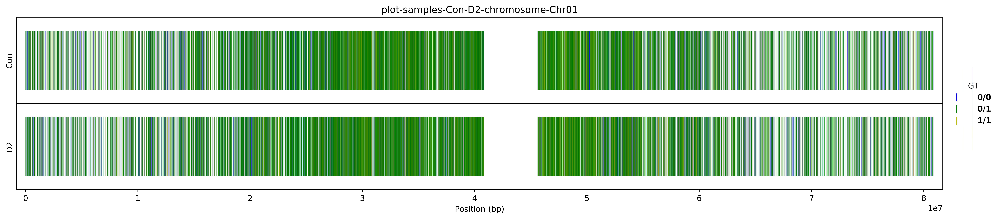

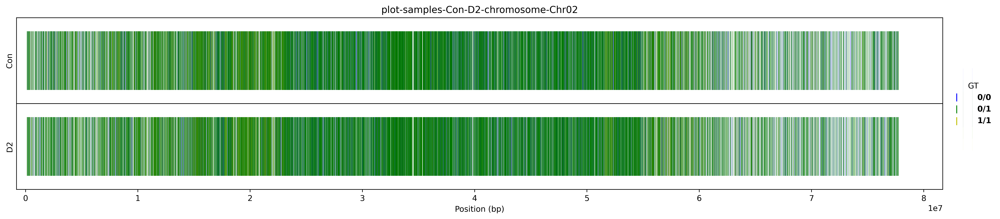

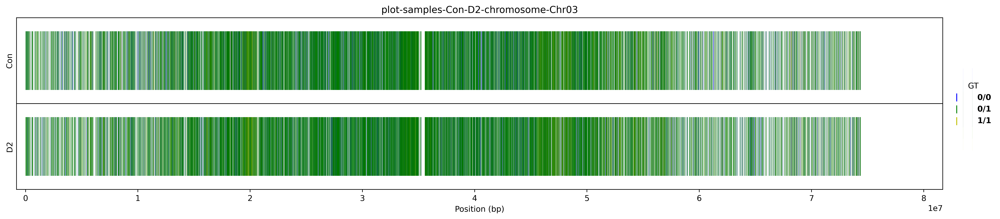

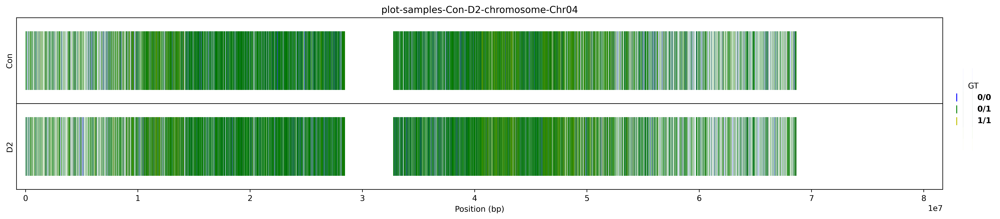

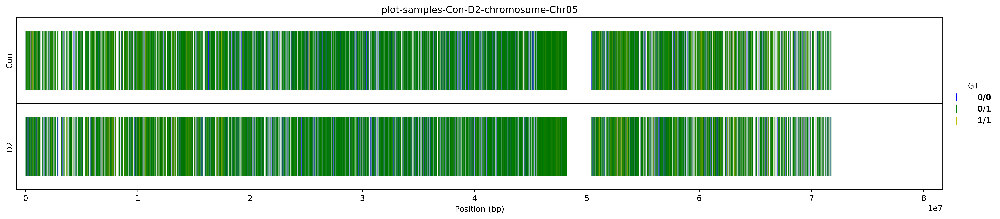

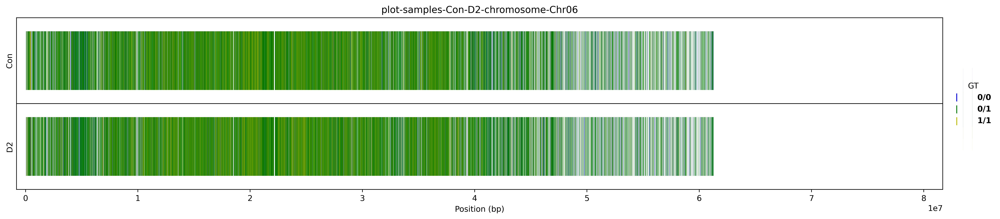

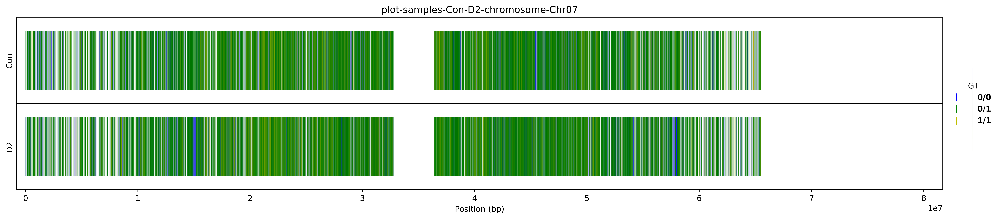

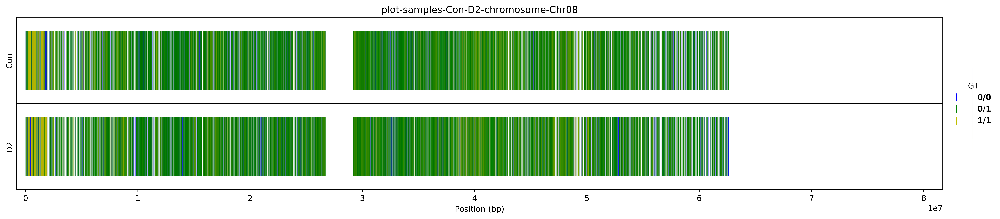

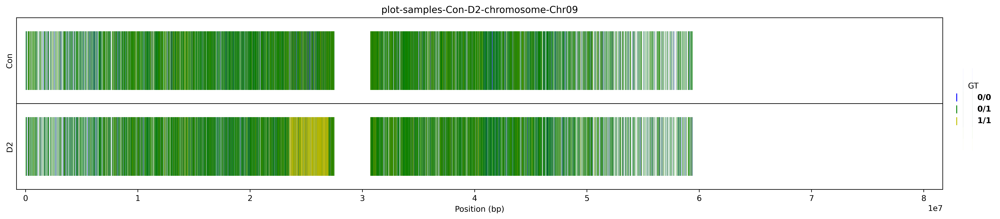

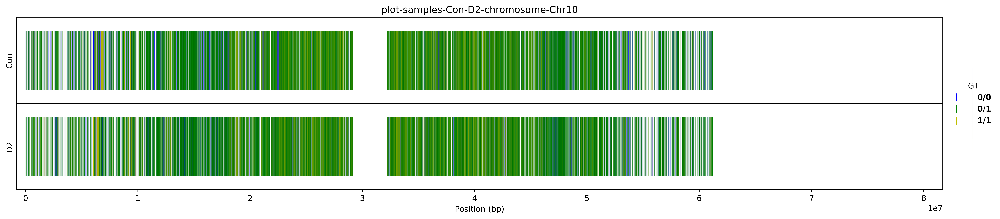

In [92]:
plt.close('all')
GTplots(samples, vcf_df_04, chrom_len_00)

## <span style="color:blue"> PART 9: Contingency Table per Chromosome</span>

In [93]:
import dataframe_image as dfi

for chromosome in chrom_len_00.index:
    chromosome_df = vcf_df_04[ vcf_df_04.CHROM == chromosome ]
    
    # reset chromosome_df indexes for contingency table
    chromosome_df.reset_index(inplace=True, drop=True)
    chromosome_ct = contingency_table(samples, chromosome_df, chromosome)


Contingency Table - Chromosome Chr01

              D2_GT                   
                0/0    0/1   1/1 other
Con_GT 0/0        0  25472   389     0
       0/1    28003  66701  3502     0
       1/1      448   3446     0     0
       other      0      0     0     0

Contingency Table - Chromosome Chr02

              D2_GT                   
                0/0    0/1   1/1 other
Con_GT 0/0        0  32080   215     0
       0/1    34767  73988  2082     0
       1/1      286   2137     0     0
       other      0      0     0     0

Contingency Table - Chromosome Chr03

              D2_GT                   
                0/0    0/1   1/1 other
Con_GT 0/0        0  28618   269     0
       0/1    31367  66932  1805     0
       1/1      324   1762     0     0
       other      0      0     0     0

Contingency Table - Chromosome Chr04

              D2_GT                   
                0/0    0/1   1/1 other
Con_GT 0/0        0  26655   182     0
       0/1    29529  6016

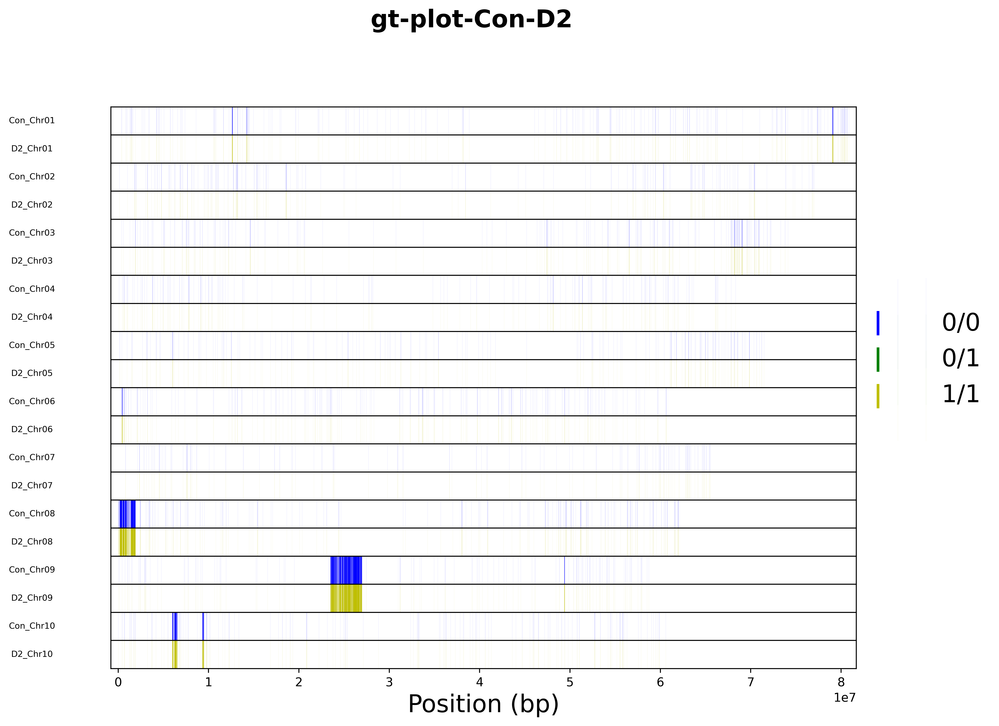

In [98]:
plt.close('all')
GTplot(samples, vcf_df_05, chrom_len_00)


In [99]:
contingency_table_6 = contingency_table(samples, vcf_df_05, 'all')


Contingency Table - Chromosome all

             D2_GT                 
               0/0 0/1    1/1 other
Con_GT 0/0       0   0  11000     0
       0/1       0   0      0     0
       1/1       0   0      0     0
       other     0   0      0     0


In [100]:
ct_guide()

Mutant              
                    0/0 0/1 1/1 other
Progenitor 0/0        a   b   c      
           0/1        d   e   f      
           1/1        g   h   i      
           other                    j

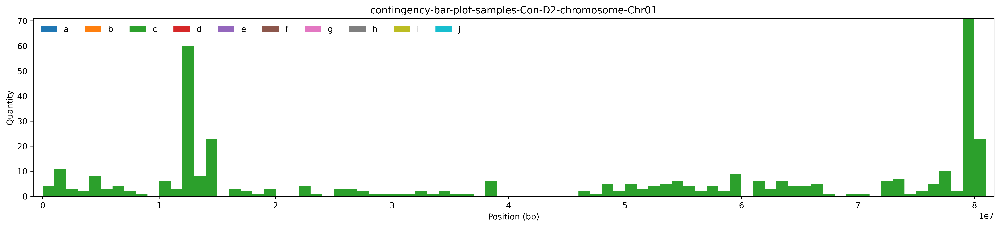

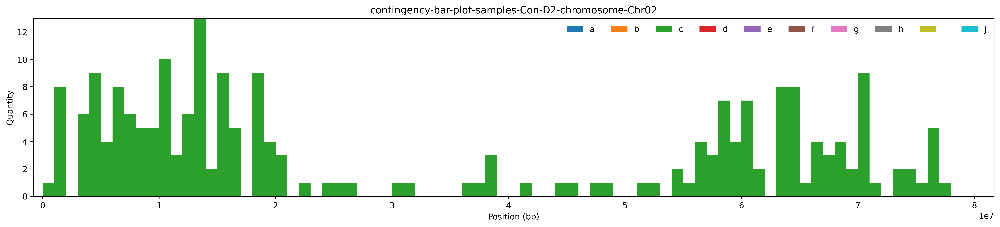

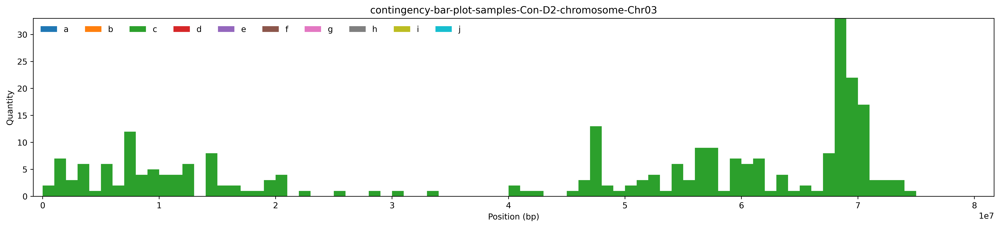

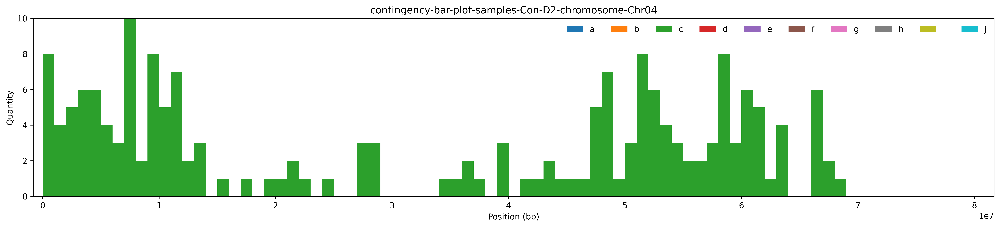

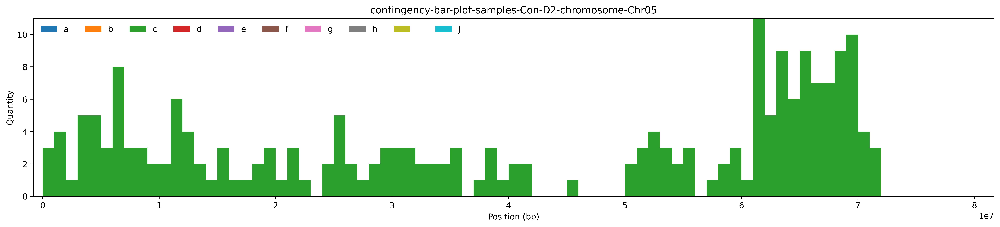

...

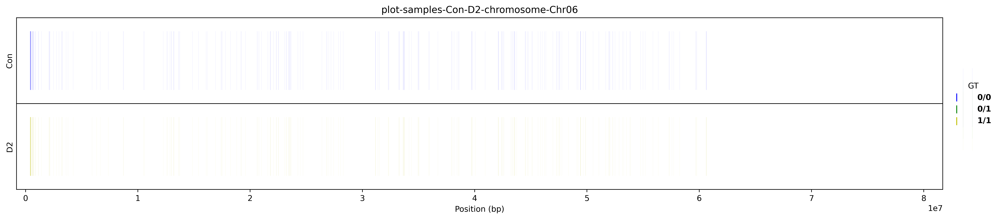

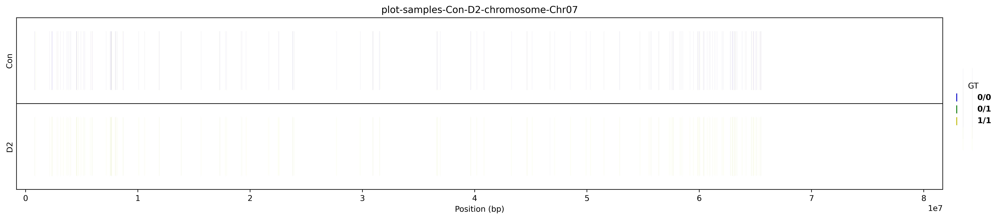

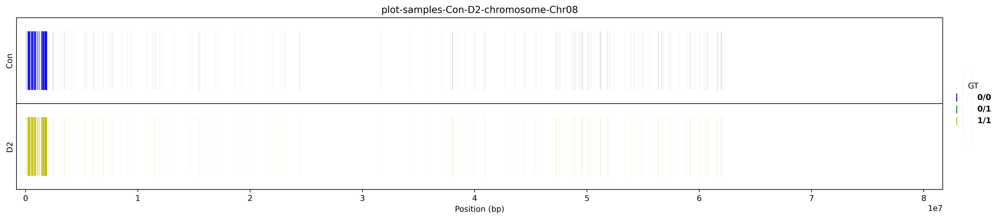

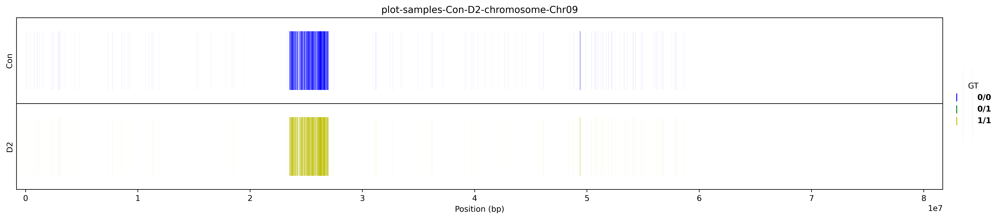

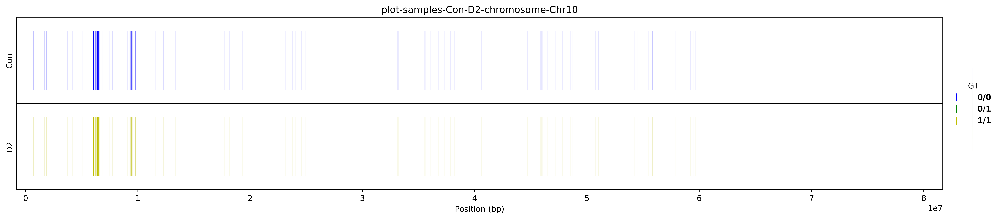


Contingency Table - Chromosome Chr01

             D2_GT               
               0/0 0/1  1/1 other
Con_GT 0/0       0   0  389     0
       0/1       0   0    0     0
       1/1       0   0    0     0
       other     0   0    0     0

Contingency Table - Chromosome Chr02

             D2_GT               
               0/0 0/1  1/1 other
Con_GT 0/0       0   0  215     0
       0/1       0   0    0     0
       1/1       0   0    0     0
       other     0   0    0     0

Contingency Table - Chromosome Chr03

             D2_GT               
               0/0 0/1  1/1 other
Con_GT 0/0       0   0  269     0
       0/1       0   0    0     0
       1/1       0   0    0     0
       other     0   0    0     0

Contingency Table - Chromosome Chr04

             D2_GT               
               0/0 0/1  1/1 other
Con_GT 0/0       0   0  182     0
       0/1       0   0    0     0
       1/1       0   0    0     0
       other     0   0    0     0

Contingency Table - Chromos

In [102]:
plt.close('all')
window_size = 1000000
CTbarPlots(samples, vcf_df_05, chrom_len_00, window_size)

# suppress all the warnings from the inverted tickes of bar plots
import warnings
warnings.filterwarnings('ignore')

plt.close('all')
GTbarPlots(samples, vcf_df_05, chrom_len_00, window_size)## <span style="color:blue"> PART 8: GT Plots per Chromosome</span>

plt.close('all')
GTplots(samples, vcf_df_05, chrom_len_00)

import dataframe_image as dfi

for chromosome in chrom_len_00.index:
    chromosome_df = vcf_df_05[ vcf_df_05.CHROM == chromosome ]
    
    # reset chromosome_df indexes for contingency table
    chromosome_df.reset_index(inplace=True, drop=True)
    chromosome_ct = contingency_table(samples, chromosome_df, chromosome)